<a href="https://colab.research.google.com/github/AabidMK/Object-Recognition-System__Infosys_Internship_Feb2025/blob/VivekVNair/ORS_VIVEKVNAIR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Task 1: Performing EDA for the COCO2017 dataset**

In [ ]:
!gdown --folder --id 1B19RWODijlUlXEdvLKxjcmlg-BiJcbWE -O /content/shared_folder

/usr/local/lib/python3.11/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Retrieving folder contents
Processing file 1tytlWWD1IqtyH3UY1cNDe5y00QJwuGh7 coco2017_subset.zip
Retrieving folder contents completed
Building directory structure
Building directory structure completed
Downloading...
From (original): https://drive.google.com/uc?id=1tytlWWD1IqtyH3UY1cNDe5y00QJwuGh7
From (redirected): https://drive.google.com/uc?id=1tytlWWD1IqtyH3UY1cNDe5y00QJwuGh7&confirm=t&uuid=3e35c2f1-f164-498b-a56d-cdde7b6b2d8c
To: /content/shared_folder/coco2017_subset.zip
100% 6.71G/6.71G [01:27<00:00, 76.9MB/s]
Download completed


In [1]:
import os
os.listdir("/content/shared_folder")

['coco2017_subset.zip']

In [ ]:
!unzip /content/shared_folder/coco2017_subset.zip -d /content/extracted_files

Streaming output truncated to the last 5000 lines.
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508801.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508836.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508855.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508861.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508878.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508881.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508906.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508938.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508969.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508972.jpg  
  inflating: /content/extracted_files/coco2017_subset/train2017/000000508984.jpg  
  inflating: /content/extracted_file

In [2]:
import os
import random
from pycocotools.coco import COCO
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import cv2

In [3]:
# Path to your COCO annotation file (change this to your subset JSON file)
ANNOTATION_FILE = '/content/extracted_files/coco2017_subset/annotation_subset/instances_train2017_subset.json'
# Folder where the corresponding images are stored
IMAGE_FOLDER = '/content/extracted_files/coco2017_subset/train2017'

In [4]:
# Initialize COCO API for instance annotations
coco = COCO(ANNOTATION_FILE)

loading annotations into memory...
Done (t=4.42s)
creating index...
index created!


In [5]:
img_ids = coco.getImgIds()
ann_ids = coco.getAnnIds()
cat_ids = coco.getCatIds()

# Load category information
categories = coco.loadCats(cat_ids)
category_names = [cat['name'] for cat in categories]

# Print basic dataset information
print("----- COCO Dataset Basic Information -----")
print(f"Total number of images: {len(img_ids)}")
print(f"Total number of annotations: {len(ann_ids)}")
print(f"Total number of categories: {len(cat_ids)}")

----- COCO Dataset Basic Information -----
Total number of images: 29571
Total number of annotations: 212806
Total number of categories: 80


loading annotations into memory...
Done (t=0.54s)
creating index...
index created!
Number of images in the validation dataset: 1250


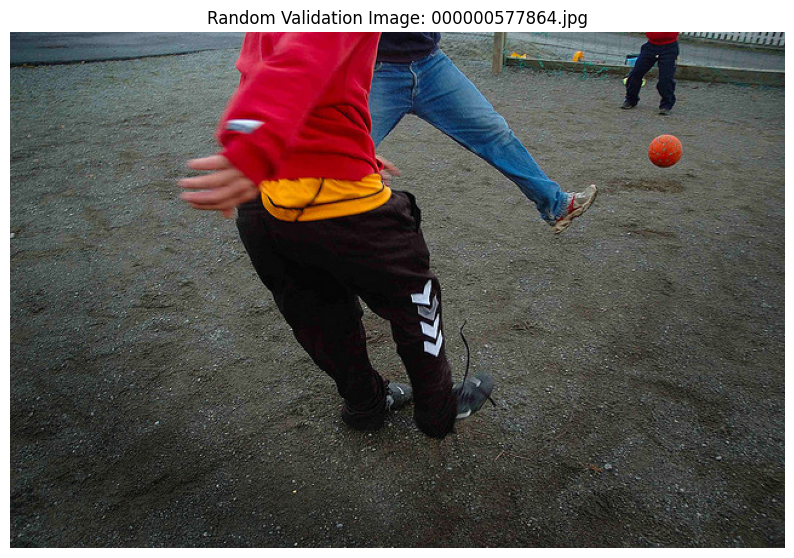

In [6]:
VAL_ANNOTATION_FILE = '/content/extracted_files/coco2017_subset/annotation_subset/instances_val2017_subset.json'
VAL_IMAGE_FOLDER = '/content/extracted_files/coco2017_subset/val2017'

# Initialize COCO API for validation annotations
coco_val = COCO(VAL_ANNOTATION_FILE)

# Retrieve all image IDs in the validation dataset
val_img_ids = coco_val.getImgIds()

# Print the number of images in the validation dataset
print("Number of images in the validation dataset:", len(val_img_ids))

# Select one random image ID from the validation dataset
rand_img_id = random.choice(val_img_ids)
img_data = coco_val.loadImgs(rand_img_id)[0]

# Construct the full image path
image_path = os.path.join(VAL_IMAGE_FOLDER, img_data['file_name'])

# Load the image using OpenCV
image = cv2.imread(image_path)
if image is None:
    print(f"Could not load image at {image_path}")
else:
    # Convert image from BGR (OpenCV's default) to RGB for displaying with matplotlib
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Display the image using matplotlib
    plt.figure(figsize=(10, 8))
    plt.imshow(image)
    plt.title(f"Random Validation Image: {img_data['file_name']}")
    plt.axis('off')
    plt.show()

In [7]:
print("Categories:", category_names)

Categories: ['person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush']


----- Category Analysis -----
person: 65165 annotations
bicycle: 1731 annotations
car: 10945 annotations
motorcycle: 2105 annotations
airplane: 1369 annotations
bus: 1449 annotations
train: 1136 annotations
truck: 2649 annotations
boat: 2815 annotations
traffic light: 2982 annotations
fire hydrant: 480 annotations
stop sign: 522 annotations
parking meter: 291 annotations
bench: 2398 annotations
bird: 2839 annotations
cat: 1227 annotations
dog: 1409 annotations
horse: 1677 annotations
sheep: 2168 annotations
cow: 1855 annotations
elephant: 1348 annotations
bear: 321 annotations
zebra: 1283 annotations
giraffe: 1311 annotations
backpack: 2243 annotations
umbrella: 2708 annotations
handbag: 3019 annotations
tie: 1618 annotations
suitcase: 1465 annotations
frisbee: 724 annotations
skis: 1701 annotations
snowboard: 709 annotations
sports ball: 1590 annotations
kite: 2239 annotations
baseball bat: 802 annotations
baseball glove: 893 annotations
skateboard: 1399 annotations
surfboard: 1507 an

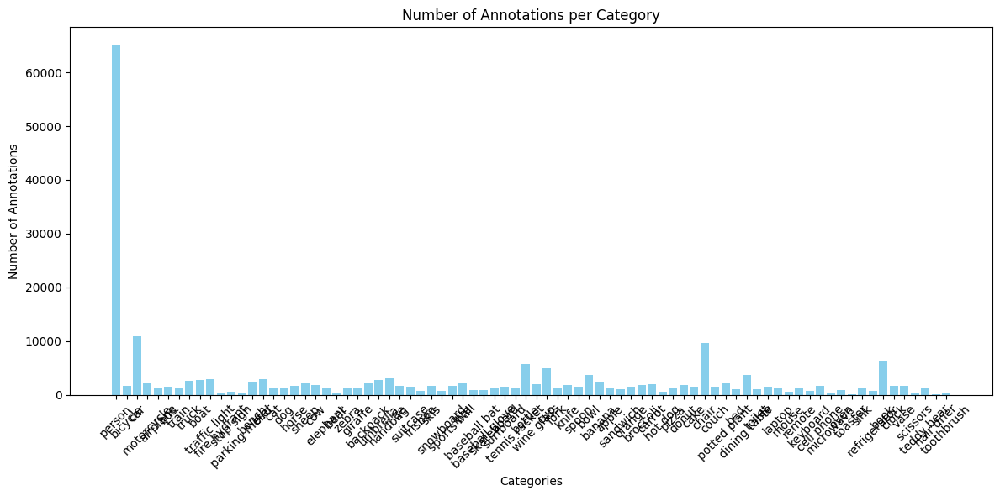

In [8]:
 category_counts = {}

for cat in categories:
    # For each category, get the number of annotations
    ann_ids = coco.getAnnIds(catIds=cat['id'])
    count = len(ann_ids)
    category_counts[cat['name']] = count

# Print out the analysis information
print("----- Category Analysis -----")
for cat_name, count in category_counts.items():
    print(f"{cat_name}: {count} annotations")

# Plot the category distribution as a bar chart
plt.figure(figsize=(12, 6))
plt.bar(category_counts.keys(), category_counts.values(), color='skyblue')
plt.xlabel("Categories")
plt.ylabel("Number of Annotations")
plt.title("Number of Annotations per Category")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

----- Annotations per Image Distribution -----
Total Images: 29571
Mean Annotations per Image: 7.20
Median Annotations per Image: 4.0
Min Annotations per Image: 0
Max Annotations per Image: 78


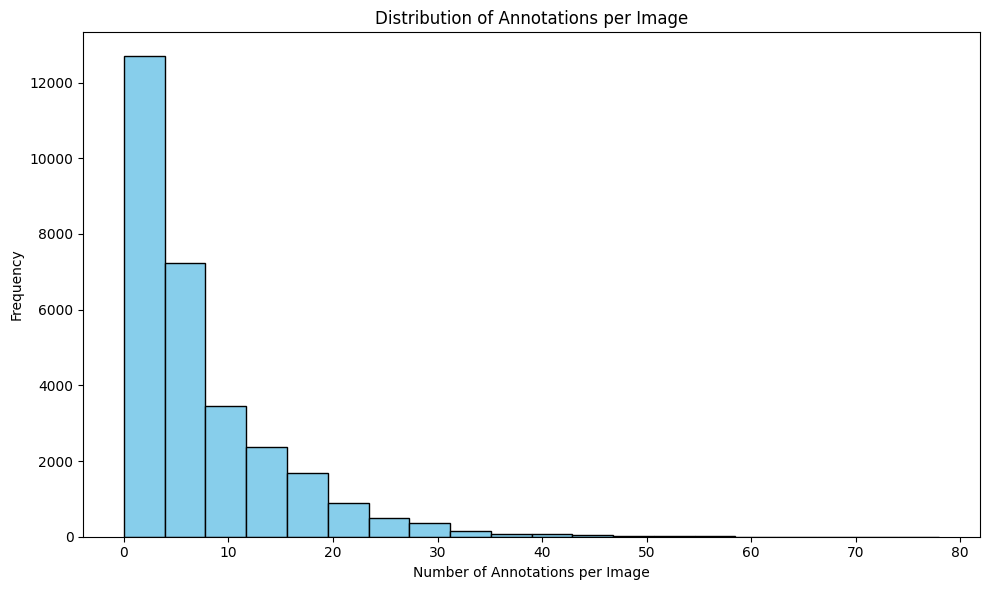

In [9]:
import numpy as np

img_ids = coco.getImgIds()

# Create a list to store the number of annotations for each image
annotations_per_image = []

# Loop through each image and count the annotations
for img_id in img_ids:
    ann_ids = coco.getAnnIds(imgIds=img_id)
    annotations_per_image.append(len(ann_ids))

# Print basic statistics
print("----- Annotations per Image Distribution -----")
print(f"Total Images: {len(img_ids)}")
print(f"Mean Annotations per Image: {np.mean(annotations_per_image):.2f}")
print(f"Median Annotations per Image: {np.median(annotations_per_image)}")
print(f"Min Annotations per Image: {np.min(annotations_per_image)}")
print(f"Max Annotations per Image: {np.max(annotations_per_image)}")

# Plot the distribution as a histogram
plt.figure(figsize=(10, 6))
plt.hist(annotations_per_image, bins=20, color='skyblue', edgecolor='black')
plt.xlabel('Number of Annotations per Image')
plt.ylabel('Frequency')
plt.title('Distribution of Annotations per Image')
plt.tight_layout()
plt.show()

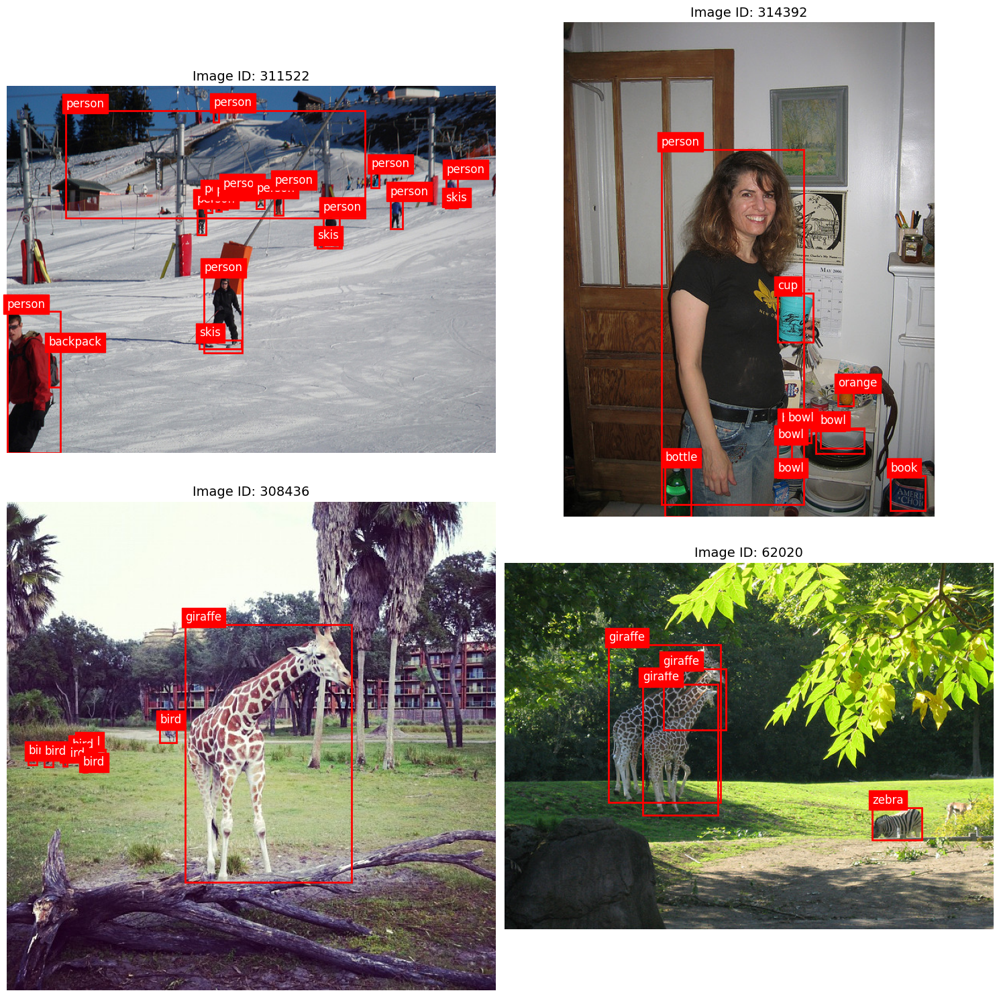

In [10]:
img_ids = coco.getImgIds()
num_samples = 4
sample_img_ids = random.sample(img_ids, num_samples)

# Set up the plot grid
fig, axs = plt.subplots(2, 2, figsize=(15, 15))
axs = axs.flatten()

# Loop through each sample image
for i, img_id in enumerate(sample_img_ids):
    # Load image metadata
    img_data = coco.loadImgs(img_id)[0]
    image_path = os.path.join(IMAGE_FOLDER, img_data['file_name'])

    # Read the image using OpenCV and convert from BGR to RGB
    image = cv2.imread(image_path)
    if image is None:
        print(f"Warning: Unable to load image at {image_path}")
        continue
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Get annotations for this image
    ann_ids = coco.getAnnIds(imgIds=img_id)
    anns = coco.loadAnns(ann_ids)

    # Display the image
    axs[i].imshow(image)
    axs[i].axis('off')
    axs[i].set_title(f"Image ID: {img_id}", fontsize=14)

    # Add bounding boxes and labels to the image
    for ann in anns:
        # COCO bounding box format: [x, y, width, height]
        bbox = ann['bbox']
        rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3],
                                 linewidth=2, edgecolor='red', facecolor='none')
        axs[i].add_patch(rect)

        # Get the category name for the annotation
        cat = coco.loadCats(ann['category_id'])[0]
        cat_name = cat['name']

        # Display the category name above the bounding box
        axs[i].text(bbox[0], bbox[1] - 5, cat_name,
                    color='white', fontsize=12, backgroundcolor='red')

plt.tight_layout()
plt.show()

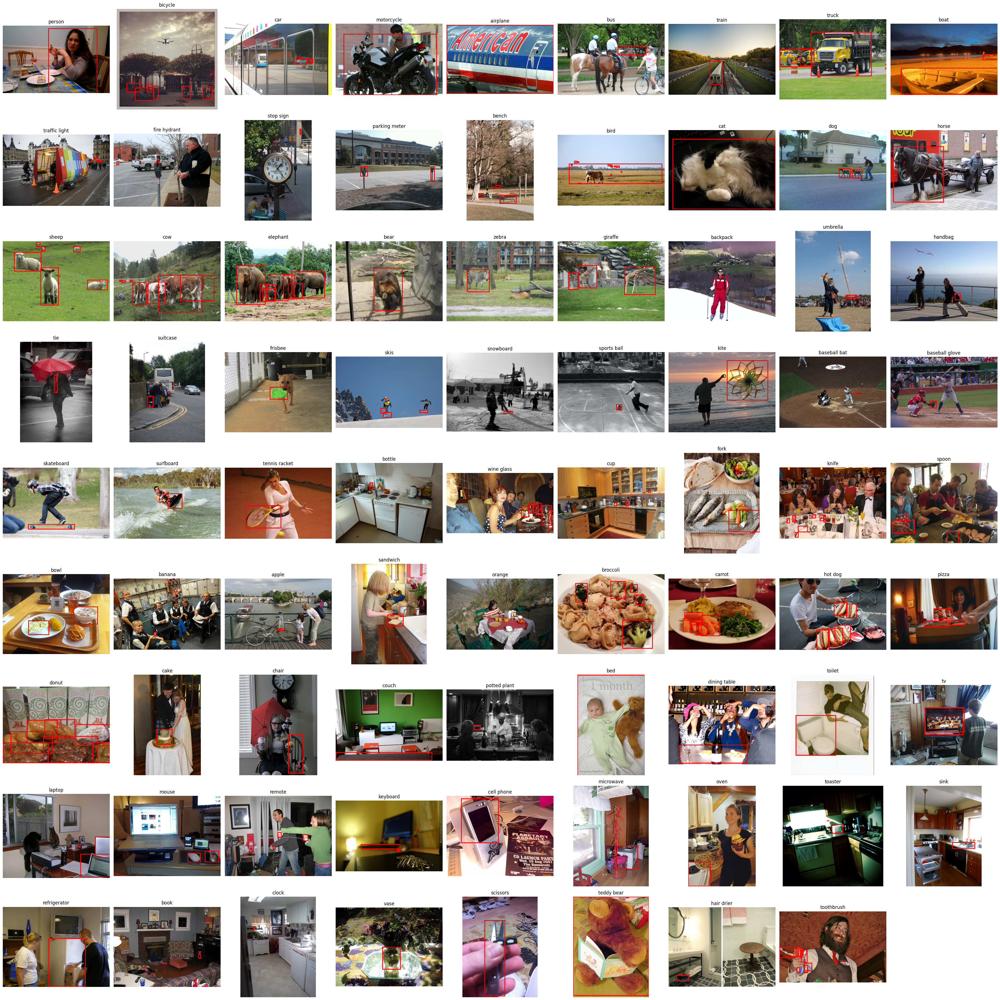

In [11]:
import math

n_categories = len(categories)

# Determine grid size for plotting (adjust grid size based on number of categories)
cols = int(math.sqrt(n_categories))
if cols * cols < n_categories:
    cols += 1
rows = math.ceil(n_categories / cols)

plt.figure(figsize=(cols * 4, rows * 4))

# Loop through each category
for i, cat in enumerate(categories):
    cat_id = cat['id']
    # Get image IDs that contain the current category
    img_ids = coco.getImgIds(catIds=[cat_id])
    if not img_ids:
        continue  # Skip if no images are found for this category

    # Select one random image that contains the category
    img_id = random.choice(img_ids)
    img_data = coco.loadImgs(img_id)[0]
    image_path = os.path.join(IMAGE_FOLDER, img_data['file_name'])

    # Load the image using OpenCV
    image = cv2.imread(image_path)
    if image is None:
        print(f"Warning: Could not load image {image_path}")
        continue
    # Convert the image from BGR (OpenCV format) to RGB (for matplotlib)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Get annotations for the selected image, but only for the current category
    ann_ids = coco.getAnnIds(imgIds=img_id, catIds=[cat_id])
    anns = coco.loadAnns(ann_ids)

    # Create subplot for the current category
    ax = plt.subplot(rows, cols, i + 1)
    ax.imshow(image)
    ax.set_title(cat['name'])
    ax.axis('off')

    # Draw bounding boxes for each annotation corresponding to the category
    for ann in anns:
        bbox = ann['bbox']  # Format: [x, y, width, height]
        rect = patches.Rectangle((bbox[0], bbox[1]), bbox[2], bbox[3],
                                 linewidth=2, edgecolor='red', facecolor='none')
        ax.add_patch(rect)

plt.tight_layout()
plt.show()

# **Task:2 Preprocessing of the images**

In [12]:
import os
import cv2
import numpy as np
from concurrent.futures import ThreadPoolExecutor  # You could also use ProcessPoolExecutor if needed

# --- Parameters ---
input_folder = '/content/extracted_files/coco2017_subset/train2017'  # Folder with original images
output_folder = '/content/extracted_files/normalized_images'         # Folder to save processed images
target_size = (256, 256)  # New dimensions (width, height)

# Create the output folder if it doesn't exist
os.makedirs(output_folder, exist_ok=True)

def process_image(image_file):
    """Read, resize, normalize, and save one image."""
    image_path = os.path.join(input_folder, image_file)
    img = cv2.imread(image_path)
    if img is None:
        print(f"Warning: Could not load image {image_path}")
        return
    # Resize the image
    resized = cv2.resize(img, target_size)
    # Normalize pixel values to [0, 1]
    normalized = resized.astype(np.float32) / 255.0
    # Save using NPZ compression to reduce disk space usage
    base_name, _ = os.path.splitext(image_file)
    output_path = os.path.join(output_folder, base_name + '.npz')
    np.savez_compressed(output_path, image=normalized)
    return output_path

def main():
    image_files = os.listdir(input_folder)
    print(f"Found {len(image_files)} images to process.")

    # Using ThreadPoolExecutor; many cv2 operations release the GIL, so threads can be efficient.
    with ThreadPoolExecutor() as executor:
        results = list(executor.map(process_image, image_files))

    for output_path in results:
        if output_path:
            print(f"Processed and saved: {output_path}")

    print("All images have been resized, normalized, and saved.")

if __name__ == '__main__':
    main()


Streaming output truncated to the last 5000 lines.
Processed and saved: /content/extracted_files/normalized_images/000000490645.npz
Processed and saved: /content/extracted_files/normalized_images/000000153624.npz
Processed and saved: /content/extracted_files/normalized_images/000000410509.npz
Processed and saved: /content/extracted_files/normalized_images/000000169885.npz
Processed and saved: /content/extracted_files/normalized_images/000000211852.npz
Processed and saved: /content/extracted_files/normalized_images/000000457168.npz
Processed and saved: /content/extracted_files/normalized_images/000000070092.npz
Processed and saved: /content/extracted_files/normalized_images/000000055585.npz
Processed and saved: /content/extracted_files/normalized_images/000000532540.npz
Processed and saved: /content/extracted_files/normalized_images/000000406710.npz
Processed and saved: /content/extracted_files/normalized_images/000000401802.npz
Processed and saved: /content/extracted_files/normalized_i

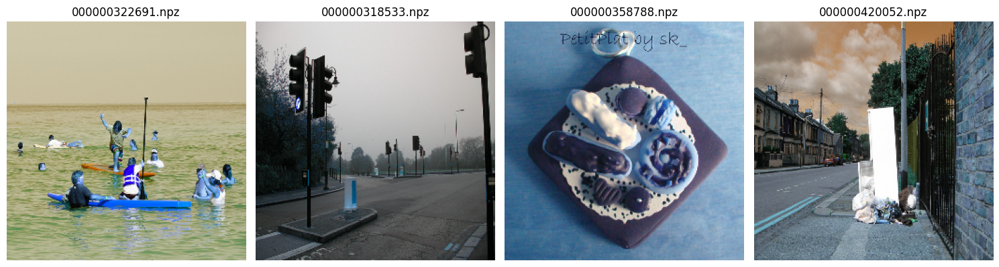

In [13]:
normalized_folder = '/content/extracted_files/normalized_images'

# List all NPZ files in the normalized folder
npz_files = [f for f in os.listdir(normalized_folder) if f.endswith('.npz')]

# Number of images to display
num_samples = 4
if len(npz_files) < num_samples:
    num_samples = len(npz_files)

# Randomly sample a few NPZ files
sample_files = random.sample(npz_files, num_samples)

# Set up the plot grid
fig, axs = plt.subplots(1, num_samples, figsize=(15, 5))
if num_samples == 1:
    axs = [axs]  # Ensure axs is iterable if there's only one sample

for ax, file in zip(axs, sample_files):
    file_path = os.path.join(normalized_folder, file)
    # Load the normalized image data from the NPZ file
    data = np.load(file_path)
    image = data['image']

    # Display the image using Matplotlib
    ax.imshow(image)
    ax.set_title(file)
    ax.axis('off')

plt.tight_layout()
plt.show()

# **Task:3 Augmentation of the images**

In [14]:
  import os
  import cv2
  import numpy as np
  import random
  import matplotlib.pyplot as plt
  from concurrent.futures import ThreadPoolExecutor

  # Paths
  NORMALIZED_FOLDER = "/content/extracted_files/normalized_images"  # Folder where normalized images are stored
  AUGMENTED_FOLDER = "/content/extracted_files/augmented_images"  # Folder to save augmented images

  # Ensure output directory exists
  os.makedirs(AUGMENTED_FOLDER, exist_ok=True)

  # ----- Augmentation Functions -----

  def convert_to_grayscale(image):
      return cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

  def random_rotation(image, angle_range=(-30, 30)):
      angle = random.uniform(*angle_range)
      h, w = image.shape[:2]
      M = cv2.getRotationMatrix2D((w/2, h/2), angle, 1)
      return cv2.warpAffine(image, M, (w, h))

  def random_flip(image):
      flip_code = random.choice([-1, 0, 1])
      return cv2.flip(image, flip_code)

  def random_translation(image, shift_range=(-10, 10)):
      h, w = image.shape[:2]
      tx, ty = random.uniform(*shift_range), random.uniform(*shift_range)
      M = np.float32([[1, 0, tx], [0, 1, ty]])
      return cv2.warpAffine(image, M, (w, h))

  def adjust_brightness_contrast(image, brightness_range=(-50, 50), contrast_range=(0.8, 1.2)):
      brightness = random.uniform(*brightness_range)
      contrast = random.uniform(*contrast_range)
      return cv2.convertScaleAbs(image, alpha=contrast, beta=brightness)

  def apply_gaussian_blur(image, kernel_size=(5, 5)):
      return cv2.GaussianBlur(image, kernel_size, 0)

  def add_gaussian_noise(image, mean=0, var=10):
      sigma = var ** 0.5
      gaussian = np.random.normal(mean, sigma, image.shape)
      noisy = np.clip(image.astype(np.float32) + gaussian, 0, 255).astype(np.uint8)
      return noisy

  # ----- Function to Process and Save Augmented Images in Parallel -----

  def process_and_save_augmentations(npz_file):
      """Loads a normalized image, applies augmentations, and saves results in parallel."""
      try:
          # Load the normalized image
          data = np.load(os.path.join(NORMALIZED_FOLDER, npz_file))
          normalized_image = data['image']

          # Convert normalized image [0,1] to uint8 [0,255] for augmentation
          image_uint8 = (normalized_image * 255).astype(np.uint8)

          # Define augmentation transformations
          aug_funcs = {
              "grayscale": convert_to_grayscale,
              "rotation": random_rotation,
              "flip": random_flip,
              "translation": random_translation,
              "brightness_contrast": adjust_brightness_contrast,
              "gaussian_blur": apply_gaussian_blur,
              "gaussian_noise": add_gaussian_noise
          }

          # Save function
          def save_augmented_image(aug_name, aug_img):
              """Saves the augmented image in JPEG format with reduced space usage."""
              save_path = os.path.join(AUGMENTED_FOLDER, f"{os.path.splitext(npz_file)[0]}_{aug_name}.jpg")
              cv2.imwrite(save_path, aug_img, [cv2.IMWRITE_JPEG_QUALITY, 80])  # Save as compressed JPEG

          # Apply augmentations in parallel
          with ThreadPoolExecutor() as executor:
              futures = {executor.submit(func, image_uint8): name for name, func in aug_funcs.items()}
              for future in futures:
                  aug_name = futures[future]
                  aug_img = future.result()
                  executor.submit(save_augmented_image, aug_name, aug_img)

      except Exception as e:
          print(f"Error processing {npz_file}: {e}")

  # ----- Main Execution -----

  # List all NPZ files (normalized images)
  npz_files = [f for f in os.listdir(NORMALIZED_FOLDER) if f.endswith('.npz')]

  # Process images in parallel
  with ThreadPoolExecutor() as executor:
      executor.map(process_and_save_augmentations, npz_files)

  print(f"Augmented images saved in {AUGMENTED_FOLDER}")


Augmented images saved in /content/extracted_files/augmented_images


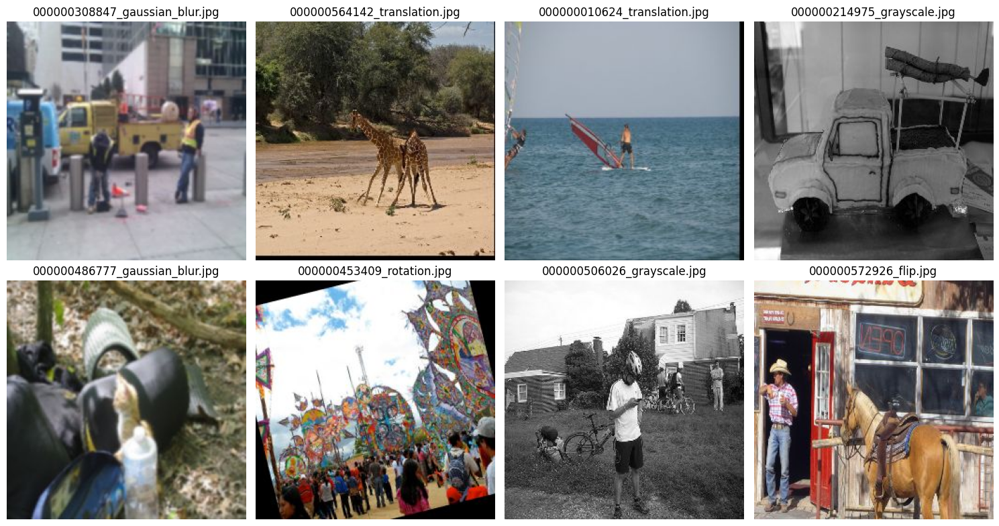

In [15]:
augmented_files = [f for f in os.listdir(AUGMENTED_FOLDER) if f.endswith('.jpg')]

# Number of images to display
num_samples = 8
if len(augmented_files) < num_samples:
    num_samples = len(augmented_files)

# Randomly sample some augmented images
sample_files = random.sample(augmented_files, num_samples)

# Set up the plot grid (e.g., 4 columns)
cols = 4
rows = (num_samples + cols - 1) // cols

plt.figure(figsize=(15, 8))
for i, file in enumerate(sample_files):
    file_path = os.path.join(AUGMENTED_FOLDER, file)
    # Load the image using OpenCV
    img = cv2.imread(file_path)
    if img is None:
        continue
    # Convert from BGR (OpenCV default) to RGB for displaying correctly
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.subplot(rows, cols, i + 1)
    plt.imshow(img_rgb)
    plt.title(file)
    plt.axis('off')

plt.tight_layout()
plt.show()

# **Task-4 Preparing YOLO training dataset**

In [16]:
#creating a yaml file
%cd /content/extracted_files/coco2017_subset

/content/extracted_files/coco2017_subset


In [17]:
import json

# Load COCO annotations
with open('/content/extracted_files/coco2017_subset/annotation_subset/instances_train2017_subset.json') as f:
    coco_data = json.load(f)

# Extract class names
class_names = [category['name'] for category in coco_data['categories']]
num_classes = len(class_names)

print("Classes:", class_names)
print("Total Classes:", num_classes)

Classes: ['person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush']
Total Classes: 80


In [18]:
import yaml

# .yaml configuration
data = {
    'path': '/content/extracted_files/coco2017_subset',    # Root directory
    'train': '/content/extracted_files/coco2017_subset/train2017',            # Path to preprocessed train images relative to root
    'val': '/content/extracted_files/coco2017_subset/val2017',                # Path to val images relative to root
    'test': '/content/extracted_files/coco2017_subset/test2017',              # Path to test images relative to root
    'nc': num_classes,                         # Number of classes (update this later if needed)
    'names': class_names                      # To be filled with class names
}

# Save the .yaml file in cocodataset folder
with open('/content/extracted_files/coco2017_subset/dataset.yaml', 'w') as file:
    yaml.dump(data, file, default_flow_style=False)

print("dataset.yaml created successfully!")


dataset.yaml created successfully!


In [19]:
!cat /content/extracted_files/coco2017_subset/dataset.yaml


names:
- person
- bicycle
- car
- motorcycle
- airplane
- bus
- train
- truck
- boat
- traffic light
- fire hydrant
- stop sign
- parking meter
- bench
- bird
- cat
- dog
- horse
- sheep
- cow
- elephant
- bear
- zebra
- giraffe
- backpack
- umbrella
- handbag
- tie
- suitcase
- frisbee
- skis
- snowboard
- sports ball
- kite
- baseball bat
- baseball glove
- skateboard
- surfboard
- tennis racket
- bottle
- wine glass
- cup
- fork
- knife
- spoon
- bowl
- banana
- apple
- sandwich
- orange
- broccoli
- carrot
- hot dog
- pizza
- donut
- cake
- chair
- couch
- potted plant
- bed
- dining table
- toilet
- tv
- laptop
- mouse
- remote
- keyboard
- cell phone
- microwave
- oven
- toaster
- sink
- refrigerator
- book
- clock
- vase
- scissors
- teddy bear
- hair drier
- toothbrush
nc: 80
path: /content/extracted_files/coco2017_subset
test: /content/extracted_files/coco2017_subset/test2017
train: /content/extracted_files/coco2017_subset/train2017
val: /content/extracted_files/coco2017_subse

In [20]:
## Process Validation Annotations and create YOLO .txt label files
import json
import os

In [21]:
# defining paths
coco_ann_file = '/content/extracted_files/coco2017_subset/annotation_subset/instances_val2017_subset.json'
output_dir = '/content/extracted_files/coco2017_subset/val2017'

In [22]:
# Load COCO annotations
with open(coco_ann_file, 'r') as f:
    coco_data = json.load(f)

In [23]:
import os
import json

# Load COCO annotations (adjust the file path as needed)
# with open('/path/to/instances_val2017.json', 'r') as f:
#     coco_data = json.load(f)

# For this example, we assume coco_data is already defined.
# Define the output directory for YOLO label files (separate from the images folder)
output_dir = "/content/extracted_files/coco2017_subset/labels"
os.makedirs(output_dir, exist_ok=True)

# Create a mapping: COCO category id -> new id (0-based contiguous indices)
coco_categories = sorted([cat['id'] for cat in coco_data['categories']])
id_mapping = {orig_id: new_id for new_id, orig_id in enumerate(coco_categories)}

# Build a mapping from image_id to image info (metadata)
img_info = {img['id']: img for img in coco_data['images']}

# Process annotations per image to convert them to YOLO format:
# YOLO format: <class> <x_center> <y_center> <width> <height> (all normalized)
annotations_by_image = {}
for ann in coco_data['annotations']:
    img_id = ann['image_id']
    img = img_info[img_id]
    img_width, img_height = img['width'], img['height']

    x, y, w, h = ann['bbox']
    # Convert from COCO bbox [x, y, w, h] to YOLO format:
    x_center = (x + w / 2) / img_width
    y_center = (y + h / 2) / img_height
    norm_w = w / img_width
    norm_h = h / img_height

    # Remap the category id using our id_mapping
    orig_cat = ann['category_id']
    if orig_cat not in id_mapping:
        continue  # Skip if the category is not in the mapping
    new_cat = id_mapping[orig_cat]

    # Group annotations by image
    if img_id not in annotations_by_image:
        annotations_by_image[img_id] = []
    annotations_by_image[img_id].append(f"{new_cat} {x_center:.6f} {y_center:.6f} {norm_w:.6f} {norm_h:.6f}")

# Write YOLO label files (one .txt file per image)
for img_id, ann_list in annotations_by_image.items():
    file_name = img_info[img_id]['file_name']
    base_name = os.path.splitext(file_name)[0]
    out_file = os.path.join(output_dir, base_name + '.txt')
    with open(out_file, 'w') as f:
        for line in ann_list:
            f.write(line + '\n')

print("Validation label files created successfully!")

# Optionally, display the contents of one sample label file for verification
# Filter for only text files to avoid picking up image files
txt_files = [f for f in os.listdir(output_dir) if f.endswith('.txt')]
if txt_files:
    sample_file = os.path.join(output_dir, txt_files[0])
    print(f"\nContents of sample label file {sample_file}:")
    with open(sample_file, 'r') as f:
        print(f.read())
else:
    print("No label files found in the output directory.")


Validation label files created successfully!

Contents of sample label file /content/extracted_files/coco2017_subset/labels/000000572555.txt:
6 0.570789 0.487271 0.684953 0.710118
9 0.610328 0.097824 0.013281 0.106376
9 0.252016 0.151859 0.020844 0.104894
9 0.427211 0.073953 0.046297 0.144800



In [24]:
#Similarly for Process Training Annotations and create YOLO .txt label files
# defining paths
coco_ann_file = '/content/extracted_files/coco2017_subset/annotation_subset/instances_train2017_subset.json'
output_dir = '/content/extracted_files/coco2017_subset/train2017'

In [25]:
# Load COCO annotations
with open(coco_ann_file, 'r') as f:
    coco_data = json.load(f)

In [26]:
import os

# Assume coco_data and output_dir are already defined and valid

# Create a mapping: COCO category id -> new id (0-based contiguous indices)
coco_categories = sorted([cat['id'] for cat in coco_data['categories']])
id_mapping = {orig_id: new_id for new_id, orig_id in enumerate(coco_categories)}

# Build a mapping from image_id to image info
img_info = {img['id']: img for img in coco_data['images']}

# Process annotations per image to convert from COCO to YOLO format
annotations_by_image = {}
for ann in coco_data['annotations']:
    img_id = ann['image_id']
    img = img_info[img_id]
    img_width, img_height = img['width'], img['height']

    x, y, w, h = ann['bbox']
    x_center = (x + w / 2) / img_width
    y_center = (y + h / 2) / img_height
    norm_w = w / img_width
    norm_h = h / img_height

    # Remap the category id
    orig_cat = ann['category_id']
    if orig_cat not in id_mapping:
        continue  # Skip if the category is not in the mapping
    new_cat = id_mapping[orig_cat]

    if img_id not in annotations_by_image:
        annotations_by_image[img_id] = []
    annotations_by_image[img_id].append(
        f"{new_cat} {x_center:.6f} {y_center:.6f} {norm_w:.6f} {norm_h:.6f}"
    )

# Write YOLO label files (one .txt file per image) in the training images folder
for img_id, ann_list in annotations_by_image.items():
    file_name = img_info[img_id]['file_name']
    base_name = os.path.splitext(file_name)[0]
    out_file = os.path.join(output_dir, base_name + '.txt')
    with open(out_file, 'w') as f:
        for line in ann_list:
            f.write(line + '\n')

print("Training label files created successfully!")

# Optionally, display the contents of one sample label file for verification
# List only .txt files to avoid binary files (like images)
txt_files = [f for f in os.listdir(output_dir) if f.endswith('.txt')]
if txt_files:
    sample_file = os.path.join(output_dir, txt_files[0])
    print(f"\nContents of sample file {sample_file}:")
    with open(sample_file, 'r') as f:
        print(f.read())
else:
    print("No label files found in the output directory.")


Training label files created successfully!

Contents of sample file /content/extracted_files/coco2017_subset/train2017/000000046728.txt:
57 0.552891 0.698915 0.325906 0.507529
56 0.818344 0.414734 0.134813 0.326189
75 0.320336 0.408314 0.053953 0.189053
56 0.202352 0.752125 0.404703 0.495751
56 0.553797 0.709249 0.330156 0.519423
57 0.206492 0.742864 0.409641 0.514273
75 0.473734 0.387783 0.032281 0.096859



# **Task-5 Training the model**

In [27]:
!pip install ultralytics

In [ ]:
import torch
from ultralytics import YOLO

# Check GPU details
print("CUDA Available:", torch.cuda.is_available())
print("GPU Name:", torch.cuda.get_device_name(0) if torch.cuda.is_available() else "No GPU found")
print("CUDA version:", torch.version.cuda)

# Load a pretrained YOLO model (using a smaller model for faster training)
model = YOLO("yolo11n.pt")  # Using a tiny model variant

# Specify the dataset YAML file with your training configuration.
data_yaml = "/content/extracted_files/coco2017_subset/dataset.yaml"

# Set training parameters for faster training:
epochs = 2         # Fewer epochs for quick experiments
img_size = 320     # Reduced image size speeds up training (adjust based on your needs)
batch_size = 16    # Increase batch size if GPU memory allows

# Choose device: GPU if available, otherwise CPU.
device = 'cuda:0' if torch.cuda.is_available() else 'cpu'
print(f"Using device: {device}")

print("Starting YOLO training...")

# Start training with optimizations:
results = model.train(
    data=data_yaml,
    epochs=epochs,
    imgsz=img_size,
    batch=batch_size,
    device=device,
    half=True,   # Enable mixed precision training for faster computation on supported GPUs
    cache=True   # Cache images to speed up data loading (if supported by your version)
)

print("Training completed.")

CUDA Available: True
GPU Name: Tesla T4
CUDA version: 12.4


100%|██████████| 5.35M/5.35M [00:00<00:00, 96.4MB/s]


Using device: cuda:0
Starting YOLO training...
Ultralytics 8.3.88 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11n.pt, data=/content/extracted_files/coco2017_subset/dataset.yaml, epochs=2, time=None, patience=100, batch=16, imgsz=320, save=True, save_period=-1, cache=True, device=cuda:0, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=True, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_

100%|██████████| 755k/755k [00:00<00:00, 24.1MB/s]



                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128

train: Scanning /content/extracted_files/coco2017_subset/train2017... 29315 images, 256 backgrounds, 0 corrupt: 100%|██████████| 29571/29571 [00:54<00:00, 537.80it/s] 


train: New cache created: /content/extracted_files/coco2017_subset/train2017.cache
WARNING ⚠️ cache='ram' may produce non-deterministic training results. Consider cache='disk' as a deterministic alternative if your disk space allows.


train: Caching images (6.1GB RAM): 100%|██████████| 29571/29571 [02:05<00:00, 235.71it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/extracted_files/coco2017_subset/val2017... 0 images, 1250 backgrounds, 0 corrupt: 100%|██████████| 1250/1250 [00:02<00:00, 528.22it/s]


val: WARNING ⚠️ No labels found in /content/extracted_files/coco2017_subset/val2017.cache. See https://docs.ultralytics.com/datasets for dataset formatting guidance.
val: New cache created: /content/extracted_files/coco2017_subset/val2017.cache
WARNING ⚠️ No labels found in /content/extracted_files/coco2017_subset/val2017.cache, training may not work correctly. See https://docs.ultralytics.com/datasets for dataset formatting guidance.
WARNING ⚠️ cache='ram' may produce non-deterministic training results. Consider cache='disk' as a deterministic alternative if your disk space allows.


val: Caching images (0.3GB RAM): 100%|██████████| 1250/1250 [00:04<00:00, 251.97it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000119, momentum=0.9) with parameter groups 81 weight(decay=0.0), 88 weight(decay=0.0005), 87 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 320 train, 320 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 2 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/2     0.881G      1.279      1.404      1.185         30        320: 100%|██████████| 1849/1849 [05:03<00:00,  6.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 40/40 [00:03<00:00, 10.66it/s]


                   all       1250          0          0          0          0          0
WARNING ⚠️ no labels found in detect set, can not compute metrics without labels


/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:619: RuntimeWarning: Mean of empty slice.
  i = smooth(f1_curve.mean(0), 0.1).argmax()  # max F1 index
/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/2     0.889G      1.061      0.978      1.072         32        320: 100%|██████████| 1849/1849 [04:47<00:00,  6.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 40/40 [00:03<00:00, 12.02it/s]

                   all       1250          0          0          0          0          0
WARNING ⚠️ no labels found in detect set, can not compute metrics without labels



/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:619: RuntimeWarning: Mean of empty slice.
  i = smooth(f1_curve.mean(0), 0.1).argmax()  # max F1 index
/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(



2 epochs completed in 0.168 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 5.5MB
Optimizer stripped from runs/detect/train/weights/best.pt, 5.5MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.88 🚀 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,616,248 parameters, 0 gradients, 6.5 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 40/40 [00:04<00:00,  9.79it/s]
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:467: RuntimeWarning: Mean of empty slice.
  ax.plot(px, py.mean(1), linewidth=3, color="blue", label=f"all classes {ap[:, 0].mean():.3f} mAP@0.5")
/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:491: RuntimeWarning: Mean of empty slice.
  y = smooth(py.mean(0), 0.05)
/usr/local/lib/python3.11/dist-packages/numpy/core/_methods.py:121: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:491: RuntimeWarning: Mean of empty slice.
  y = smooth(py.mean(0), 0.05)
/usr/local/lib/python3.11/dist-packages/numpy/core/_me

                   all       1250          0          0          0          0          0
WARNING ⚠️ no labels found in detect set, can not compute metrics without labels


/usr/local/lib/python3.11/dist-packages/ultralytics/utils/metrics.py:619: RuntimeWarning: Mean of empty slice.
  i = smooth(f1_curve.mean(0), 0.1).argmax()  # max F1 index


Speed: 0.1ms preprocess, 0.8ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/train
Training completed.


RuntimeError: Parent directory /content/drive/MyDrive/Yolo_Models does not exist.

In [ ]:
# Define the directory where you want to save the model.
save_dir = "/content/drive/MyDrive/Yolo_Models"
# Create the directory if it doesn't exist.
os.makedirs(save_dir, exist_ok=True)

# Save the trained model to the specified path.
model.save(os.path.join(save_dir, "trained_model.pt"))
print("Model saved successfully!")

Model saved successfully!
